In [1]:
import os
if os.getcwd().endswith("test"):
    os.chdir("..")

In [2]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
from utils.FrameUtils import *

In [3]:
plt.rcParams['figure.figsize'] = [20, 9]

In [4]:
def load_img(file, base_path="RecordTest"):
    img = cv.imread(f"{base_path}/{file}", cv.IMREAD_GRAYSCALE)
    return img

In [5]:
def plot_img(img):
    plt.imshow(img, cmap='gray')

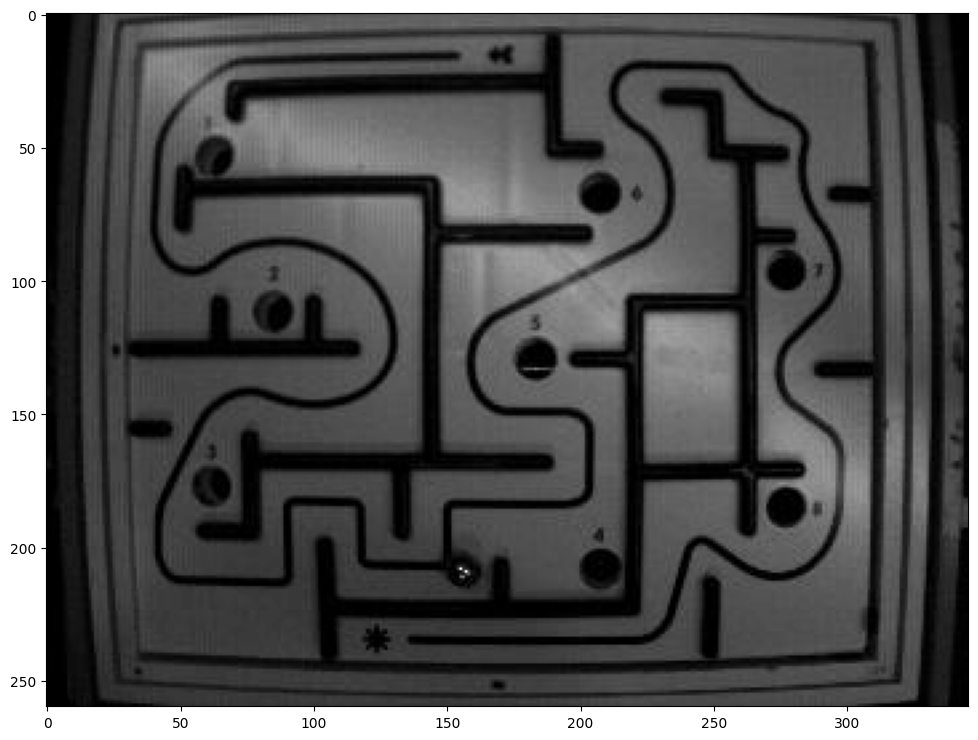

In [6]:
pattern2_img = load_img("img-70.jpg")
plot_img(pattern2_img)

[[ 5  4  4  5  6  6  5  3  5]
 [ 0  0  0  0  0  0  0  0  3]
 [ 2  1  0  1  3  3  2  1  1]
 [21 20 19 19 19 19 20 21 19]
 [49 49 48 48 48 48 49 49 49]
 [70 69 69 68 68 69 69 70 72]
 [74 74 73 73 73 73 74 74 77]
 [78 77 77 76 76 77 77 78 80]
 [80 79 79 78 78 79 79 80 81]]


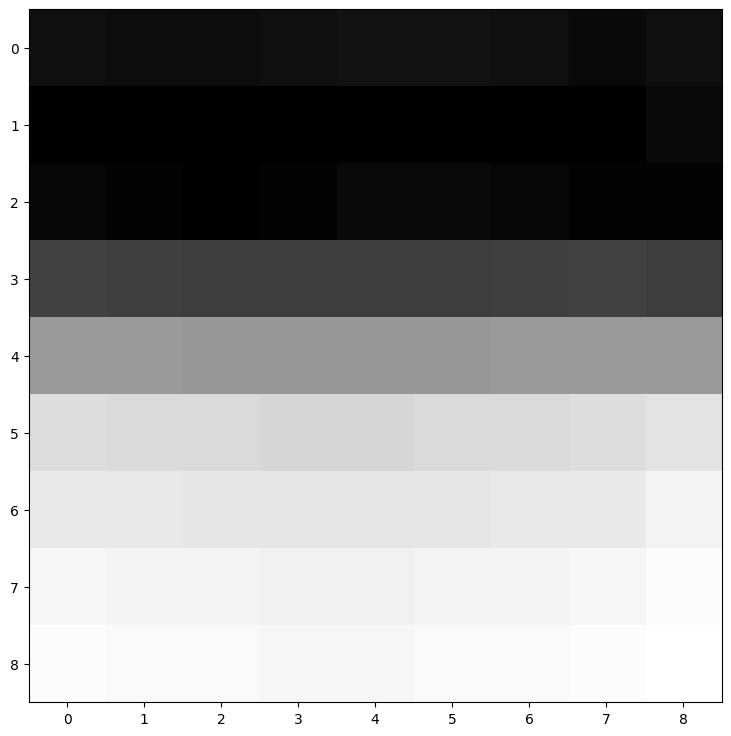

In [7]:
pattern = pattern2_img[125:134, 88:97]
plt.imshow(pattern, cmap='gray')
print(pattern)

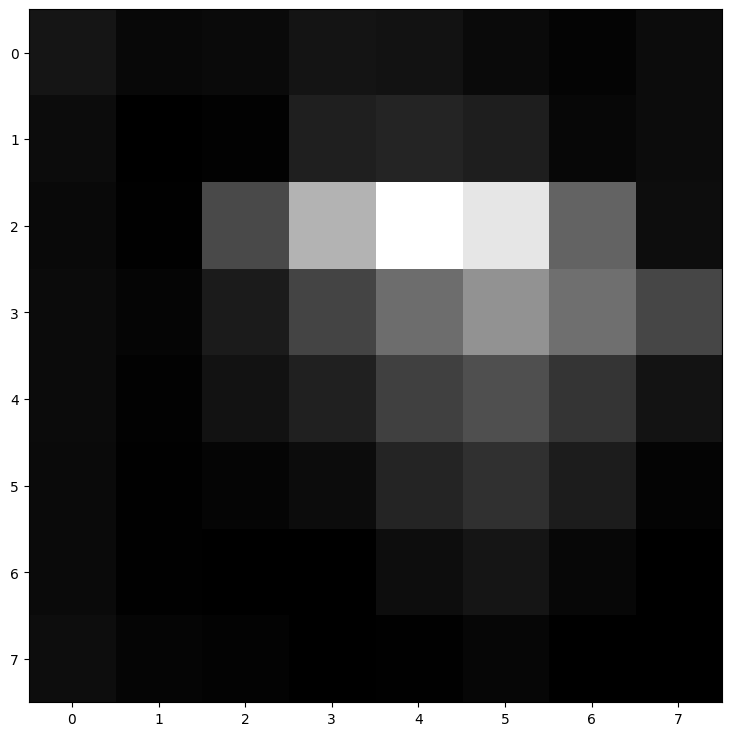

In [8]:
pattern = np.array([
[21,8,10,20,18,10,4,12],
[12,0,2,31,37,30,7,12],
[9,1,73,180,255,230,99,13],
[11,5,27,68,109,146,111,70],
[11,2,18,32,64,79,52,19],
[10,1,5,12,37,49,28,4],
[10,1,0,0,13,21,7,0],
[13,5,3,0,1,6,0,0]
], dtype=np.uint8)
plot_img(pattern)

In [15]:
p_vals =   [[44,  34,  6,   0,  17,  25,  20,  32,  48],
			[39,   8,  8,  54,  27,  30,  21,  21,  38],
			[ 9,   3, 80, 173,  72,  36,  26,  26,  28],
			[15,  12, 78, 255, 248,  91,  54,  24,  24],
			[12,  13, 37,  96, 184, 247, 179,  32,  22],
			[23,  10, 10,  24,  61, 111, 103,  43,  24],
			[22,  13, 38, 150, 143,  39,  21,  10,  31],
			[40,  32, 19,  71,  76,  29,  29,   9,  38],
			[54,  46, 51,  18,   7,  23,  16,  31,  45]]
pattern = np.array(p_vals, dtype=np.uint8)

In [16]:
def match_ball_pattern(img):
    return cv.matchTemplate(img, pattern, cv.TM_CCOEFF)

In [17]:
plt.rcParams['figure.figsize'] = [20, 400]
num = 200
cols = 4
rows = int(np.ceil(num / cols))
fig, ax = plt.subplots(nrows=rows, ncols=cols)
for i in range(rows):
    for j in range(cols):
        res = match_ball_pattern(load_img(f"img-{i * cols + j + 1830}.jpg"))
        min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
        ax[i, j].scatter([max_loc[0]], [max_loc[1]])
        ax[i, j].imshow(res, cmap='inferno')
        ax[i, j].set_title(f"max value: {max_val}")
fig.tight_layout()